In [ ]:
!pip install -q --upgrade transformers diffusers ftfy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 47.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 851.8/851.8 kB 64.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.1/200.1 kB 26.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 119.8 MB/s eta 0:00:00


In [ ]:
!pip install accelerate

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 215.3/215.3 kB 19.6 MB/s eta 0:00:00


In [ ]:
from base64 import b64encode

import numpy
import torch
from diffusers import AutoencoderKL, LMSDiscreteScheduler, UNet2DConditionModel
from huggingface_hub import notebook_login

# For video display:
from IPython.display import HTML
from matplotlib import pyplot as plt
from pathlib import Path
from PIL import Image
from torch import autocast
from torchvision import transforms as tfms
from tqdm.auto import tqdm
from transformers import CLIPTextModel, CLIPTokenizer, logging

torch.manual_seed(1)
if not (Path.home()/'.huggingface'/'token').exists(): notebook_login()

# Supress some unnecessary warnings when loading the CLIPTextModel
logging.set_verbosity_error()

# Set device
torch_device = "cuda" if torch.cuda.is_available() else "cpu"

In [ ]:
from fastcore.all import concat
import logging

# 1. Stable diffusion Pipeline

In [ ]:
from diffusers import StableDiffusionPipeline
pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4",revision="fp16",torch_dtype = torch.float16).to("cuda")

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

/usr/local/lib/python3.9/dist-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


In [ ]:
!ls ~/.cache/huggingface/diffusers/

ls: cannot access '/root/.cache/huggingface/diffusers/': No such file or directory


In [ ]:
prompt = "a photograph of an astronaut riding a horse "


  0%|          | 0/50 [00:00<?, ?it/s]

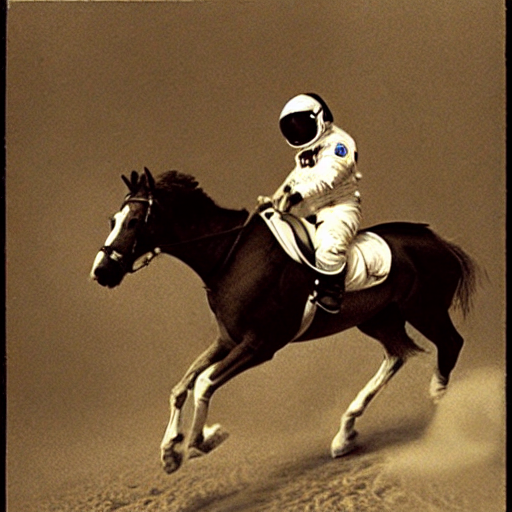

In [ ]:
pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

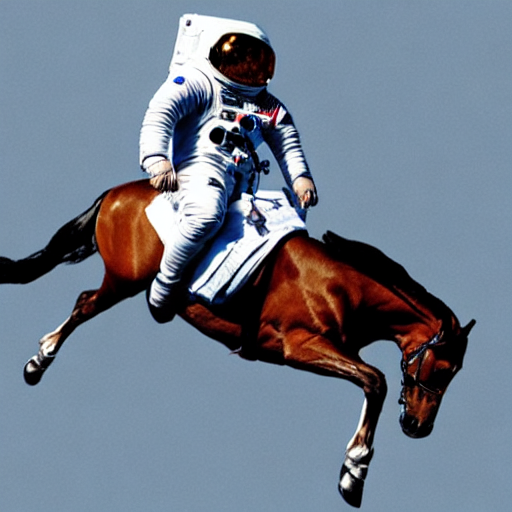

In [ ]:
torch.manual_seed(1024)
pipe(prompt).images[0]

  0%|          | 0/5 [00:00<?, ?it/s]

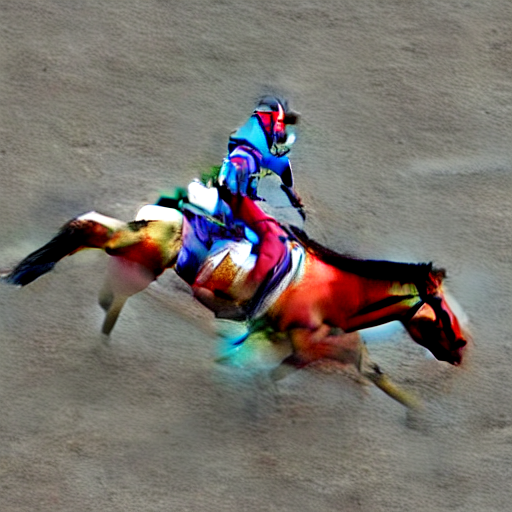

In [ ]:
torch.manual_seed(1024)
pipe(prompt, num_inference_steps=5).images[0]

  0%|          | 0/19 [00:00<?, ?it/s]

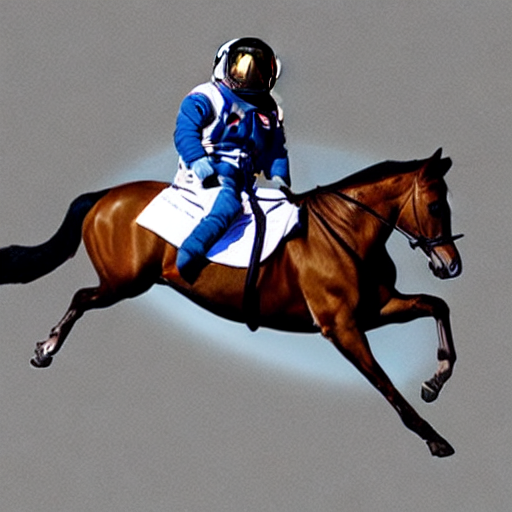

In [ ]:
torch.manual_seed(1024)
pipe(prompt, num_inference_steps=19).images[0]

## 1.1.2 Classifier-Free Guidance

In [ ]:
def image_grid(imgs, rows, cols):
  w,h = imgs[0].size
  grid = Image.new('RGB', size=(cols*w, rows*h))
  for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
  return grid

### Classifier-Free Guidance is a method to increase the adherence of the output to the conditioning signal we used(the text). Roughly speaking, the larger the guidance the more the model tries to represent the text prompt. However, large values tend to produce less diversity. The default is 7.5, which represents a good compromise between variety and fidelity. The default is 7.5, which represents a good compromise between variety and fidelity. 
### We can generate multiple images for the same prompt by simplypassing a list of prompts instead of a string.

In [ ]:
num_rows, num_cols = 4,4
prompts = [prompt] * num_cols
images = concat(pipe(prompts, guidance_scale = g).images for g in [1.1,3,7,14])

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

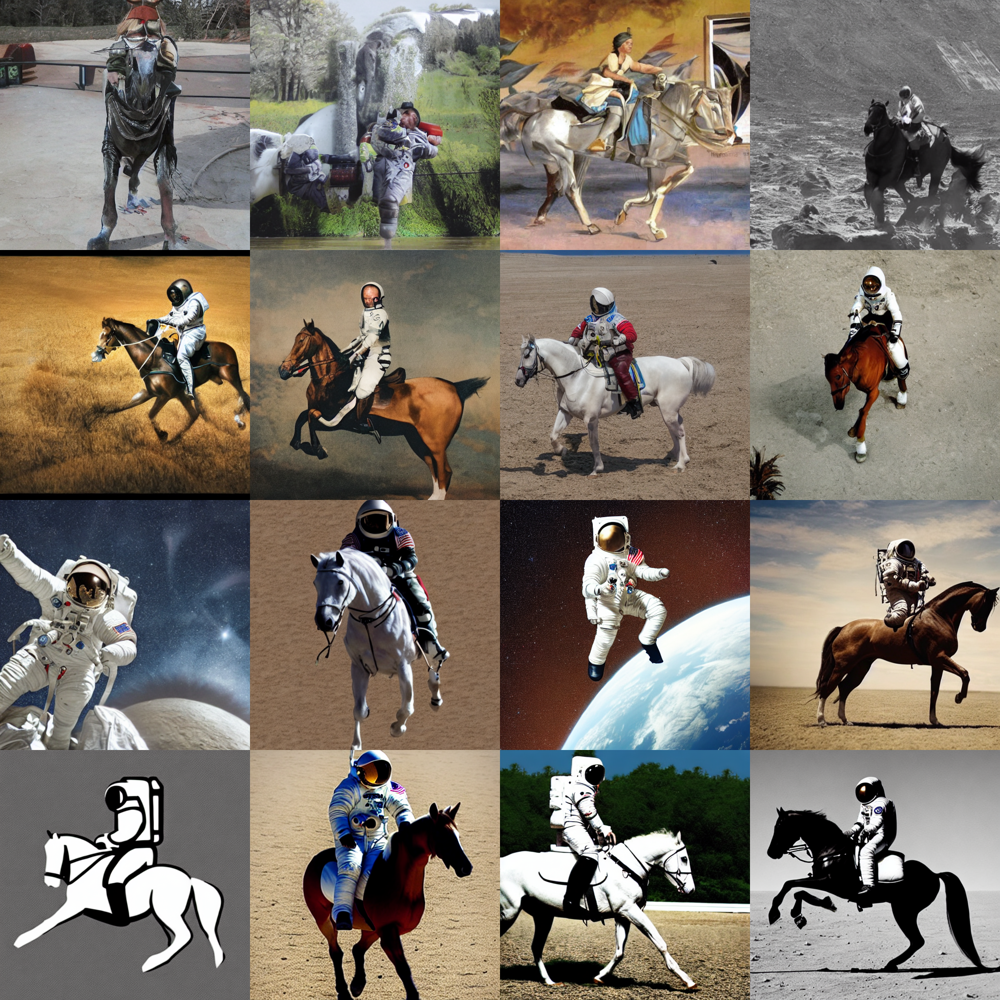

In [ ]:
image_grid(images, rows=num_rows, cols=num_cols)

### 1.1.3 Negative prompts
Negative prompting refers to the use of another prompt(instead of a completely unconditioned generation), and scaling the difference between generations of that prompt and the conditioned generation.

  0%|          | 0/50 [00:00<?, ?it/s]

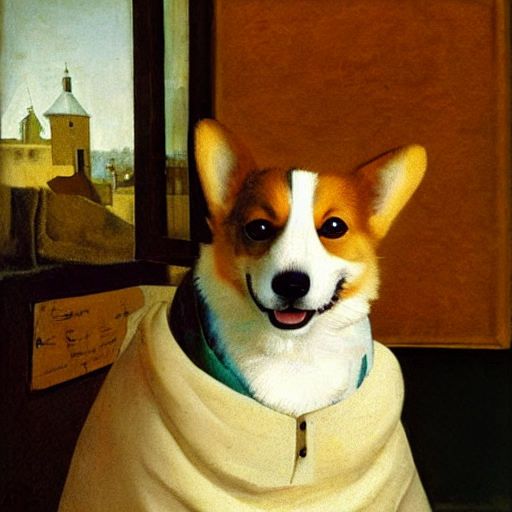

In [ ]:
torch.manual_seed(10)
prompt = 'Corgi in the style of Vermeer'
pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

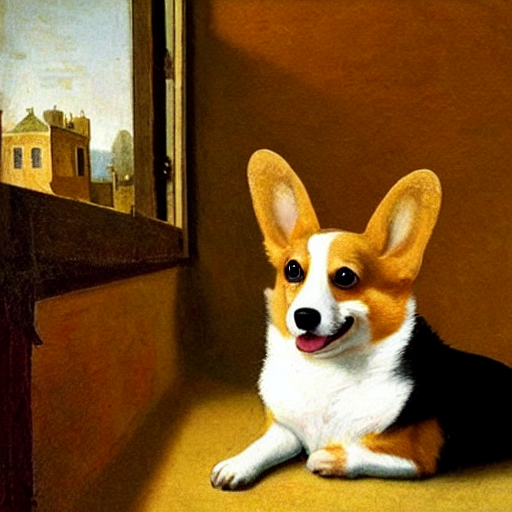

In [ ]:
torch.manual_seed(10)
pipe(prompt, negative_prompt='blue').images[0]

### 1.1.4 Image to Image
Even though Stable Diffusion was trained to negerate images, and optionally drive the generation using text conditioning, we can use the raw image diffusion process for other tasks.
For example, instead of starting from pure noise, we can start from an image an add a certain amount of noise to it. We are replacing the initial steps of the denoising and pretending our image is what the algorithm came up with, Then we continue the diffusion process from taht state as usual.
This usually preserves the composition although details may change a lot. It's great for sketches.
These operations(provide an initial image, add some noise to it and run diffusion from there) can be automatically performed by a special image to image pipeline:    
StableDiffusionImg2ImgPipeline. 

In [ ]:
from diffusers import StableDiffusionImg2ImgPipeline
from fastdownload import FastDownload

pipei2i = StableDiffusionImg2ImgPipeline.from_pretrained(
    "CompVis/stable-diffusion-v1-4",
    reVision='fp16',
    torch_dtype=torch.float16,
).to('cuda')

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

Keyword arguments {'reVision': 'fp16'} are not expected by StableDiffusionImg2ImgPipeline and will be ignored.


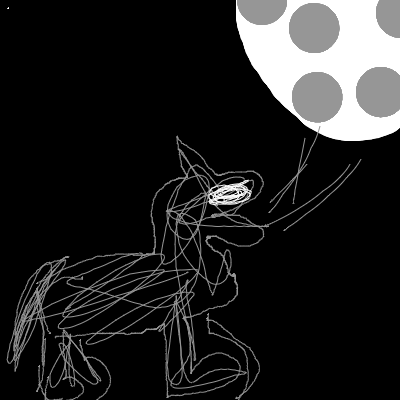

In [ ]:
p = FastDownload().download('https://s3.amazonaws.com/moonup/production/uploads/1664665907257-noauth.png')
init_image = Image.open(p).convert("RGB")
init_image

  0%|          | 0/40 [00:00<?, ?it/s]

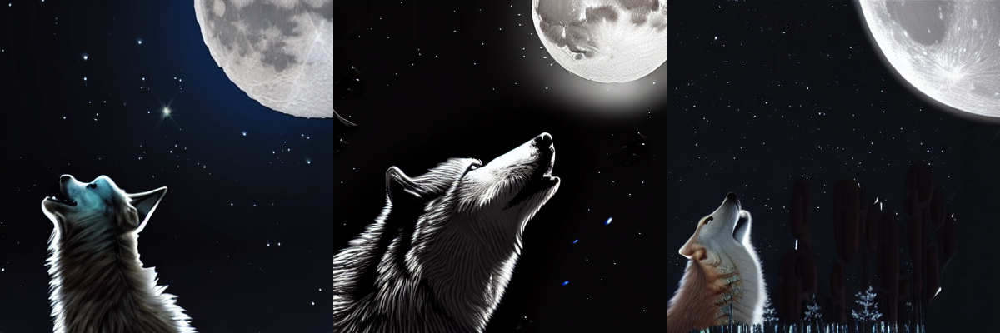

In [ ]:
torch.manual_seed(10)
prompt = 'Wolf howling at the moon, photorealistic 4K'
init_images = [init_image] * 3
images = pipei2i(prompt=prompt, num_images_per_prompt=3, image=init_images, strength=0.8, num_inference_steps=50).images
image_grid(images, rows=1, cols=3)

In [ ]:
init_image = images[1]

/usr/local/lib/python3.9/dist-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion_img2img.py:551: FutureWarning: You have passed 3 text prompts (`prompt`), but only 1 initial images (`image`). Initial images are now duplicating to match the number of text prompts. Note that this behavior is deprecated and will be removed in a version 1.0.0. Please make sure to update your script to pass as many initial images as text prompts to suppress this warning.
  deprecate("len(prompt) != len(image)", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/70 [00:00<?, ?it/s]

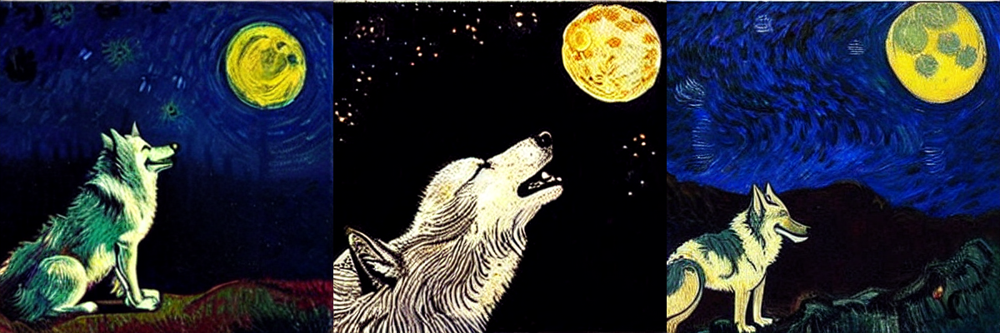

In [ ]:
torch.manual_seed(10)
prompt = 'oil painting of wolf howling at the moon by Van Gogh'
images = pipei2i(prompt=prompt, num_images_per_prompt=3, image=init_image, strength=1, num_inference_steps=70).images
image_grid(images, rows=1, cols=3)

In [ ]:
pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", revision="fp16", torch_dtype=torch.float16) 
pipe = pipe.to("cuda")

In [ ]:
embeds_url = "https://huggingface.co/sd-concepts-library/indian-watercolor-portraits/resolve/main/learned_embeds.bin"
embeds_path = FastDownload().download(embeds_url)
embeds_dict = torch.load(str(embeds_path), map_location="cpu")

In [ ]:
tokenizer = pipe.tokenizer
text_encoder = pipe.text_encoder
new_token, embeds = next(iter(embeds_dict.items()))
embeds = embeds.to(text_encoder.dtype)
new_token

'<watercolor-portrait>'

In [ ]:
assert tokenizer.add_tokens(new_token) == 1, "The token already exists!"

In [ ]:
text_encoder.resize_token_embeddings(len(tokenizer))
new_token_id = tokenizer.convert_tokens_to_ids(new_token)
text_encoder.get_input_embeddings().weight.data[new_token_id] = embeds

  0%|          | 0/50 [00:00<?, ?it/s]

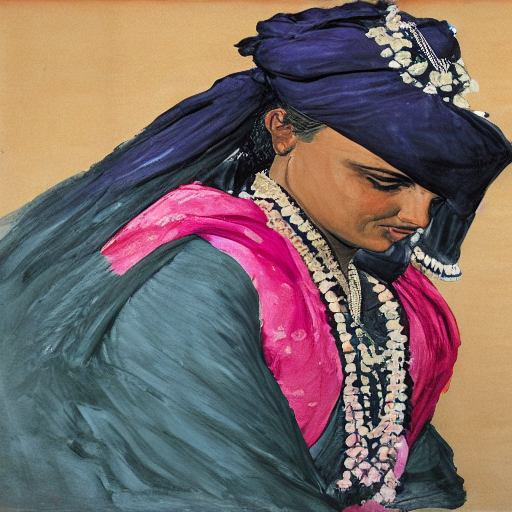

In [ ]:
torch.manual_seed(1024)
image = pipe("Woman reading in the style of <watercolor-portrait>").images[0]
image

In [ ]:
pipe = StableDiffusionPipeline.from_pretrained("pcuenq/jh_dreambooth_1000", torch_dtype=torch.float16)
pipe = pipe.to("cuda")

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

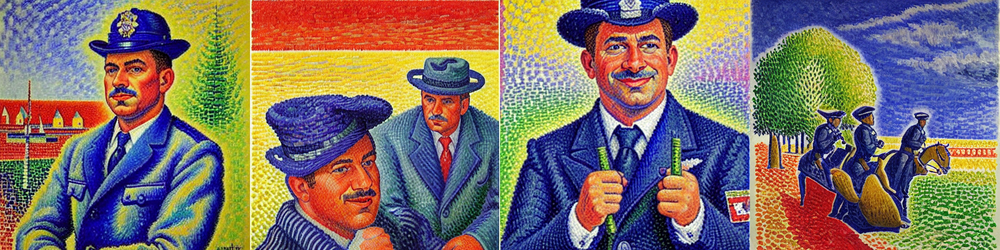

In [ ]:
torch.manual_seed(1000)

prompt = "Painting of police in the style of Paul Signac"
images = pipe(prompt, num_images_per_prompt=4).images
image_grid(images, 1, 4)

  0%|          | 0/50 [00:00<?, ?it/s]

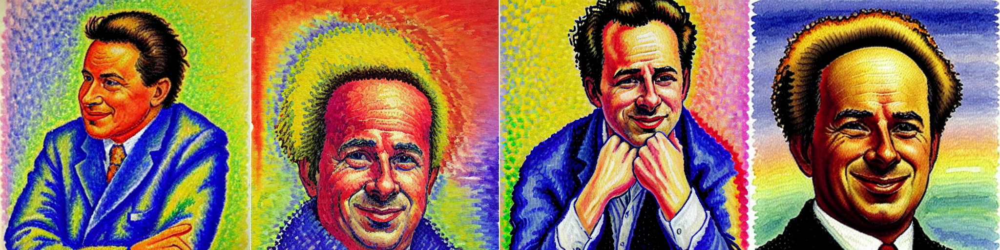

In [ ]:
torch.manual_seed(1000)

prompt = "Painting of sks person in the style of Paul Signac"
images = pipe(prompt, num_images_per_prompt=4).images
image_grid(images, 1, 4)